In [41]:
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objs as go
from scipy.optimize import minimize

In [29]:
def calculate_mse(y):
    if len(y) == 0:
        return 0
    mean_y = np.mean(y)
    mse = np.mean((y - mean_y) ** 2)
    return mse

In [30]:
class DecisionNode:
    def __init__(self, threshold=None, left=None, right=None, value=None):
        self.threshold = threshold
        self.left = left
        self.right = right
        self.value = value

class DecisionTreeRegressor:
    def __init__(self, max_depth=None, min_samples_split=100):
        self.max_depth = max_depth
        self.min_samples_split = min_samples_split
        self.root = None

    def fit(self, X, y):
        self.root = self._grow_tree(X, y, 0)

    def _grow_tree(self, X, y, depth):
        if depth >= self.max_depth or len(y) < self.min_samples_split:
            if len(y) == 0:
                return DecisionNode(value=0)
            return DecisionNode(value=np.mean(y))

        thr = self._best_split(X, y)

        left_idxs, right_idxs = X < thr, X >= thr
        left = self._grow_tree(X[left_idxs], y[left_idxs], depth + 1)
        right = self._grow_tree(X[right_idxs], y[right_idxs], depth + 1)
        return DecisionNode(threshold=thr, left=left, right=right)

    def _best_split(self, X, y):

        def threshold_loss(threshold, X, y):
            left_data = y[X < threshold]
            right_data = y[X >= threshold]
            
            left_mse = calculate_mse(left_data)
            right_mse = calculate_mse(right_data)
            
            mse_reduction = left_mse + right_mse
            
            return mse_reduction 

        initial_threshold = np.mean(X)
                
        result = minimize(threshold_loss, initial_threshold, args=(X, y))

        threshold = result.x
        return threshold

    def predict(self, X):
        return np.array([self._predict(inputs) for inputs in X])
    
    def _predict(self, input):
        node = self.root
        while node.value is None:
            if input < node.threshold:
                node = node.left
            else:
                node = node.right
        return node.value

Error: 0.00010031926183558158


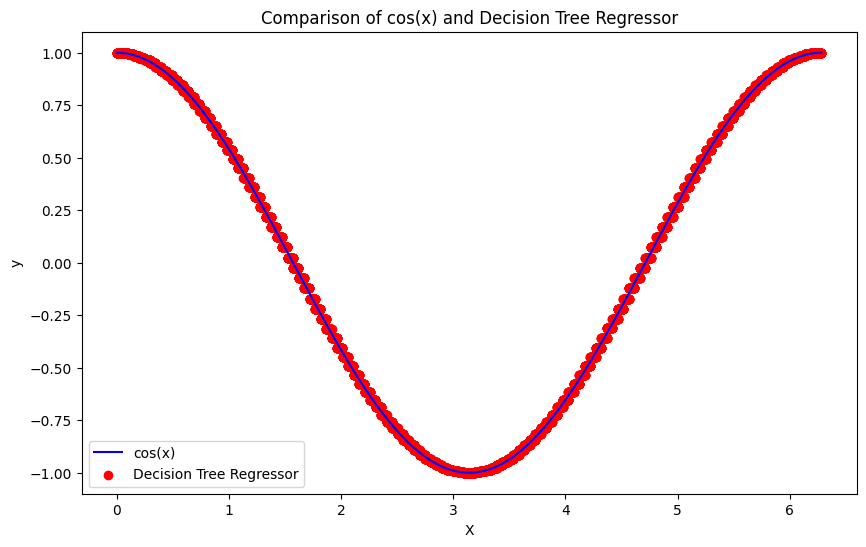

In [31]:
X = np.linspace(0, 2 * np.pi, 10000)  # X values
y = np.cos(X).ravel()  # y values (cos(x))

# Create and train the decision tree regressor from scratch
# regressor = DecisionTreeRegressor(max_depth=12)
regressor = DecisionTreeRegressor(max_depth=8)
regressor.fit(X, y)

# Predict on the generated dataset
y_pred = regressor.predict(X)
print(f"Error: {np.mean((y - y_pred) ** 2)}")


# Plotting both the cos(x) and the decision tree regressor predictions
plt.figure(figsize=(10, 6))
plt.plot(X, y, label='cos(x)', color='blue')
plt.scatter(X, y_pred, label='Decision Tree Regressor', color='red')
plt.xlabel('X')
plt.ylabel('y')
plt.title('Comparison of cos(x) and Decision Tree Regressor')
plt.legend()
plt.show()

In [112]:
class MultiDimensionalDecisionTreeRegressor:
    def __init__(self, max_depth=None, min_samples_split=100):
        self.max_depth = max_depth
        self.trees = []
        self.min_samples_split = min_samples_split

    def fit(self, X, y):
        for target_dim in range(y.shape[1]):
            tree = DecisionTreeRegressor(max_depth=self.max_depth, min_samples_split=self.min_samples_split)
            tree.fit(X, y[:, target_dim])
            self.trees.append(tree)

    def predict(self, X):
        predictions = []
        for tree in self.trees:
            predictions.append(tree.predict(X))
        return np.array(predictions).T

In [113]:
radius = 1
center = (0, 0)

theta = np.linspace(0, 2*np.pi, 100000)
x_circle = center[0] + radius * np.cos(theta)
y_circle = center[1] + radius * np.sin(theta)

y = np.vstack((x_circle, y_circle)).T
X = np.linspace(0, 1, 100000)

In [114]:
X.shape, y.shape

((100000,), (100000, 2))

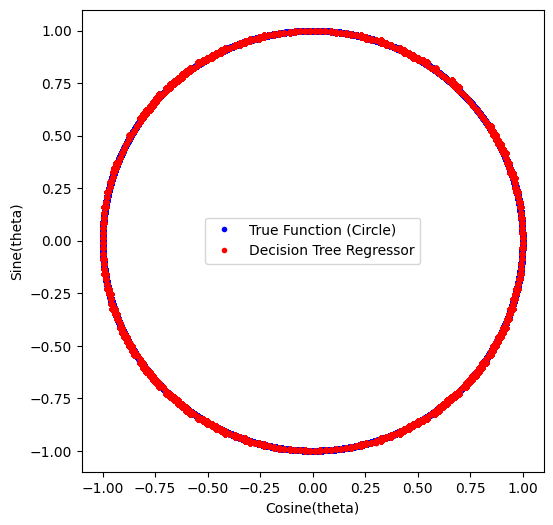

In [115]:
# regressor_circle = DecisionTreeRegressor(max_depth=8)
regressor_circle = MultiDimensionalDecisionTreeRegressor(max_depth=8)
regressor_circle.fit(X, y)

y_pred = regressor_circle.predict(X)

plt.figure(figsize=(6, 6))
plt.plot(y[:, 0], y[:, 1], '.', label='True Function (Circle)', color='blue')
plt.plot(y_pred[:, 0], y_pred[:, 1], '.', label='Decision Tree Regressor', color='red')
plt.xlabel('Cosine(theta)')
plt.ylabel('Sine(theta)')
plt.legend()
plt.gca().set_aspect('equal', adjustable='box')
plt.show()

In [160]:
from tqdm.contrib.concurrent import thread_map

# RandomForest doesn't change anything but idxs = np.random.choice(len(X), len(X), replace=True) does some unexpleniable magic
class RandomForestRegressor:

    def __init__(self, num_trees=100, max_depth=3, workers=4, min_samples_split=100):
        self.num_trees = num_trees
        self.max_depth = max_depth
        self.workers = workers
        self.min_samples_split = min_samples_split
        self.trees = []

    def fit(self, X, y):

        def train_random_tree(i):
            regressor = MultiDimensionalDecisionTreeRegressor(max_depth=self.max_depth, min_samples_split=self.min_samples_split)
            idxs = np.random.choice(len(X), len(X), replace=True)
            regressor.fit(X[idxs], y[idxs])
            return regressor
        
        self.trees = thread_map(train_random_tree, range(self.num_trees), max_workers=self.workers)

    def predict(self, X):
        def predict_tree(tree):
            return tree.predict(X)
        predictions = np.mean(thread_map(predict_tree, self.trees, max_workers=self.workers), axis=0)
        return predictions
    

In [161]:
def loss(y_true, y_pred):
    return np.mean((y_true - y_pred) ** 2)

In [175]:
radius = 1
num_points = 300

theta = np.linspace(0, np.pi, num_points)
phi = np.linspace(0, 2 * np.pi, num_points)

theta, phi = np.meshgrid(theta, phi)

r_xy = radius*np.sin(theta)
x_sphere = np.cos(phi) * r_xy
y_sphere = np.sin(phi) * r_xy
z_sphere = radius * np.cos(theta)

y = np.vstack((x_sphere.flatten(), y_sphere.flatten(), z_sphere.flatten())).T
X = np.linspace(0, 1, y.shape[0])

In [176]:
y.shape, X.shape

((90000, 3), (90000,))

In [185]:
regressor_sphere = MultiDimensionalDecisionTreeRegressor(max_depth=10, min_samples_split=10)
idxs = np.random.choice(len(X), len(X), replace=True) # magic line XD
regressor_sphere.fit(X[idxs], y[idxs])
y_pred = regressor_sphere.predict(X)
loss(y, y_pred)

0.08136728867645784

In [186]:
fig = go.Figure()
fig.add_trace(go.Scatter3d(x=y_pred[:, 0], y=y_pred[:, 1], z=y_pred[:, 2], mode='markers', name='Decision Tree Regressor', marker=dict(color='red', size=4)))
fig.add_trace(go.Surface(x=x_sphere, y=y_sphere, z=z_sphere, name='Sphere', colorscale='blues', opacity=0.6))
fig.update_layout(scene=dict(xaxis_title='X', yaxis_title='Y', zaxis_title='Z'), title='Sphere')
fig.show()

In [187]:
regressor_sphere = MultiDimensionalDecisionTreeRegressor(max_depth=16, min_samples_split=10)
idxs = np.random.choice(len(X), len(X), replace=True) # magic line XD
regressor_sphere.fit(X[idxs], y[idxs])
y_pred = regressor_sphere.predict(X)
loss(y, y_pred)

0.007238440940167265

In [190]:
fig = go.Figure()
fig.add_trace(go.Scatter3d(x=y_pred[:, 0], y=y_pred[:, 1], z=y_pred[:, 2], mode='markers', name='Decision Tree Regressor', marker=dict(color='red', size=4)))
fig.add_trace(go.Surface(x=x_sphere, y=y_sphere, z=z_sphere, name='Sphere', colorscale='blues', opacity=0.6))
fig.update_layout(scene=dict(xaxis_title='X', yaxis_title='Y', zaxis_title='Z'), title='Sphere')
fig.show()